학습은 kaggle에 미리 받아놓은 데이터셋을 다운로드 받아서 colab에서 진행했습니다.

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("geon05/dataset2")
path2 = kagglehub.dataset_download("geon05/damages-masks")

print("Path to dataset files:", path)
print("Path to dataset files:", path2)

100%|██████████| 17.7G/17.7G [14:52<00:00, 21.3MB/s]

Extracting files...


100%|██████████| 13.9G/13.9G [12:18<00:00, 20.2MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/geon05/dataset2/versions/1
Path to dataset files: /root/.cache/kagglehub/datasets/geon05/damages-masks/versions/1


Loaded model state from /content/20241207_05_best_model_1_0.046.pth, continuing training...


Epoch [1/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [1/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [1/50] Train Loss: 0.0458, Val Loss: 0.0471
Epoch [1] Mean SSIM (no-mask): 0.9901, Mean Histogram Similarity (no-mask): 0.5248
Epoch [1] Combined Metric (no-mask): 0.5196
** Best Model Updated and Saved! **


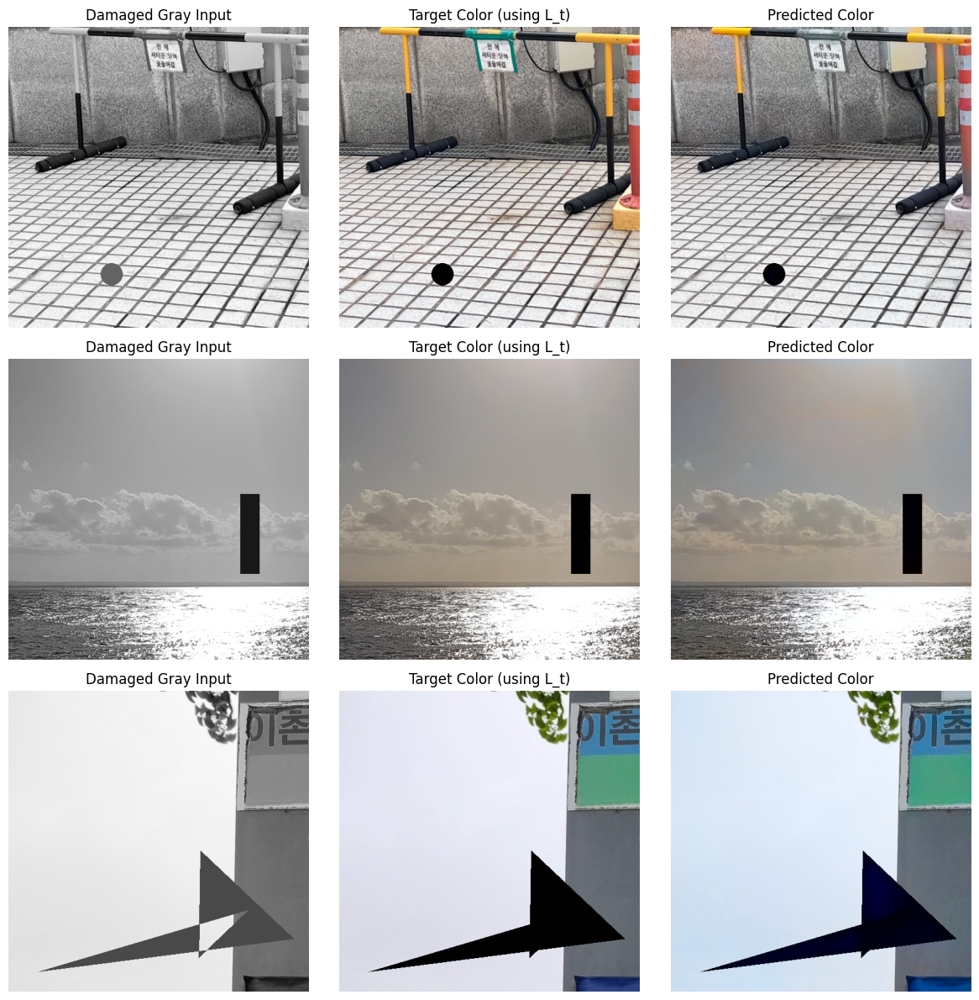

Epoch [2/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [2/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [2/50] Train Loss: 0.0444, Val Loss: 0.0466
Epoch [2] Mean SSIM (no-mask): 0.9920, Mean Histogram Similarity (no-mask): 0.5443
Epoch [2] Combined Metric (no-mask): 0.5399
** Best Model Updated and Saved! **


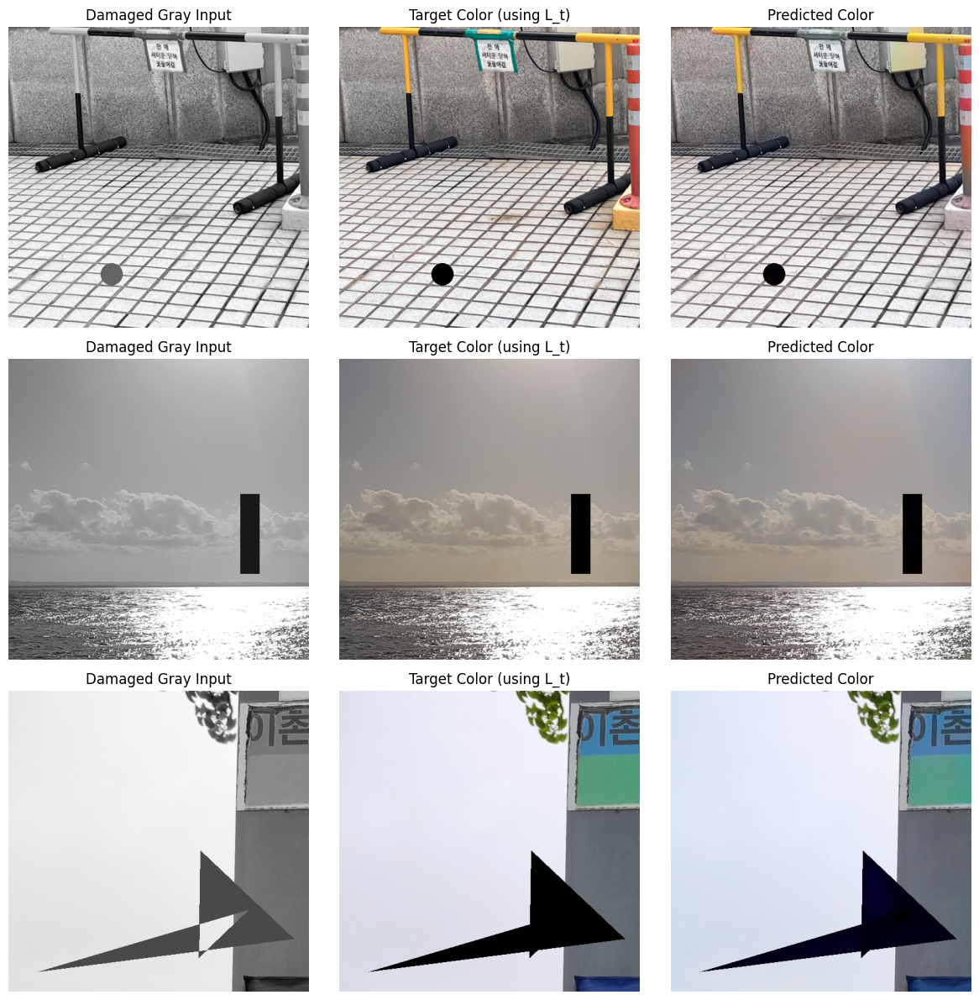

Epoch [3/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [3/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [3/50] Train Loss: 0.0439, Val Loss: 0.0482
Epoch [3] Mean SSIM (no-mask): 0.9877, Mean Histogram Similarity (no-mask): 0.5587
Epoch [3] Combined Metric (no-mask): 0.5518
** Best Model Updated and Saved! **


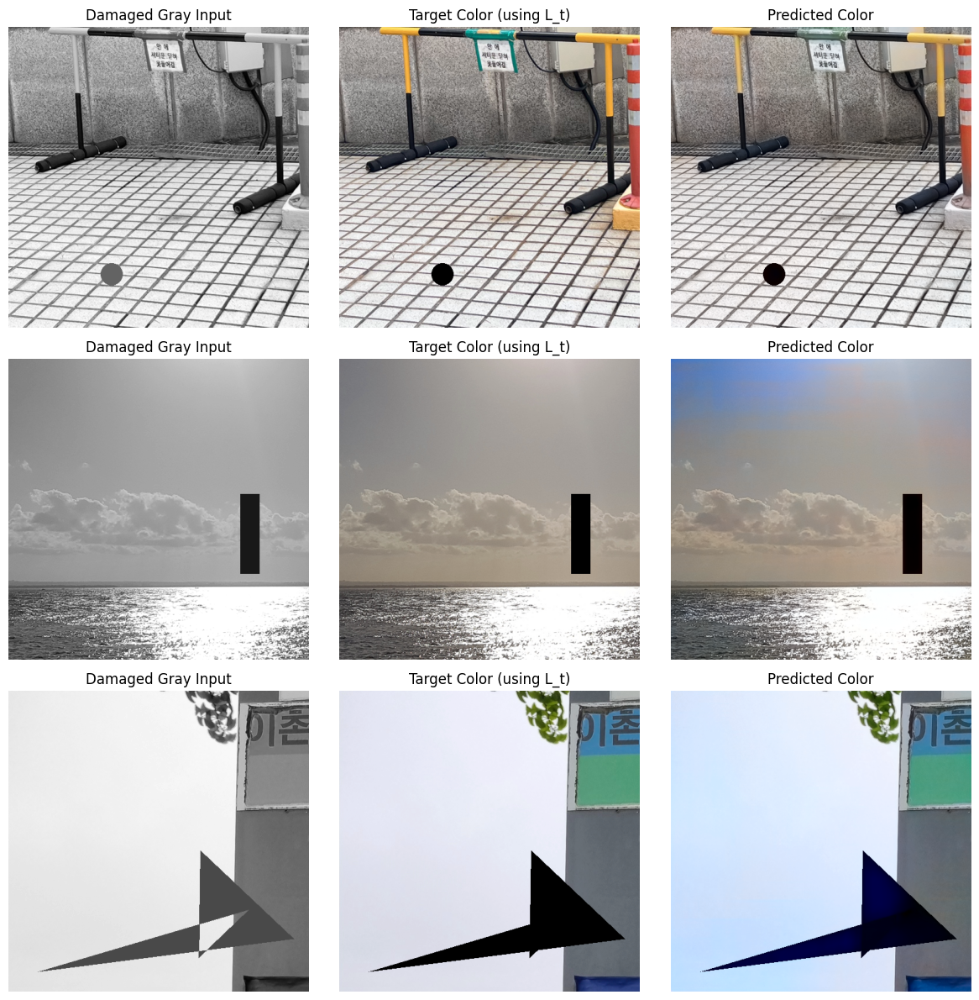

Epoch [4/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [4/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [4/50] Train Loss: 0.0439, Val Loss: 0.0548
Epoch [4] Mean SSIM (no-mask): 0.9910, Mean Histogram Similarity (no-mask): 0.3145
Epoch [4] Combined Metric (no-mask): 0.3117


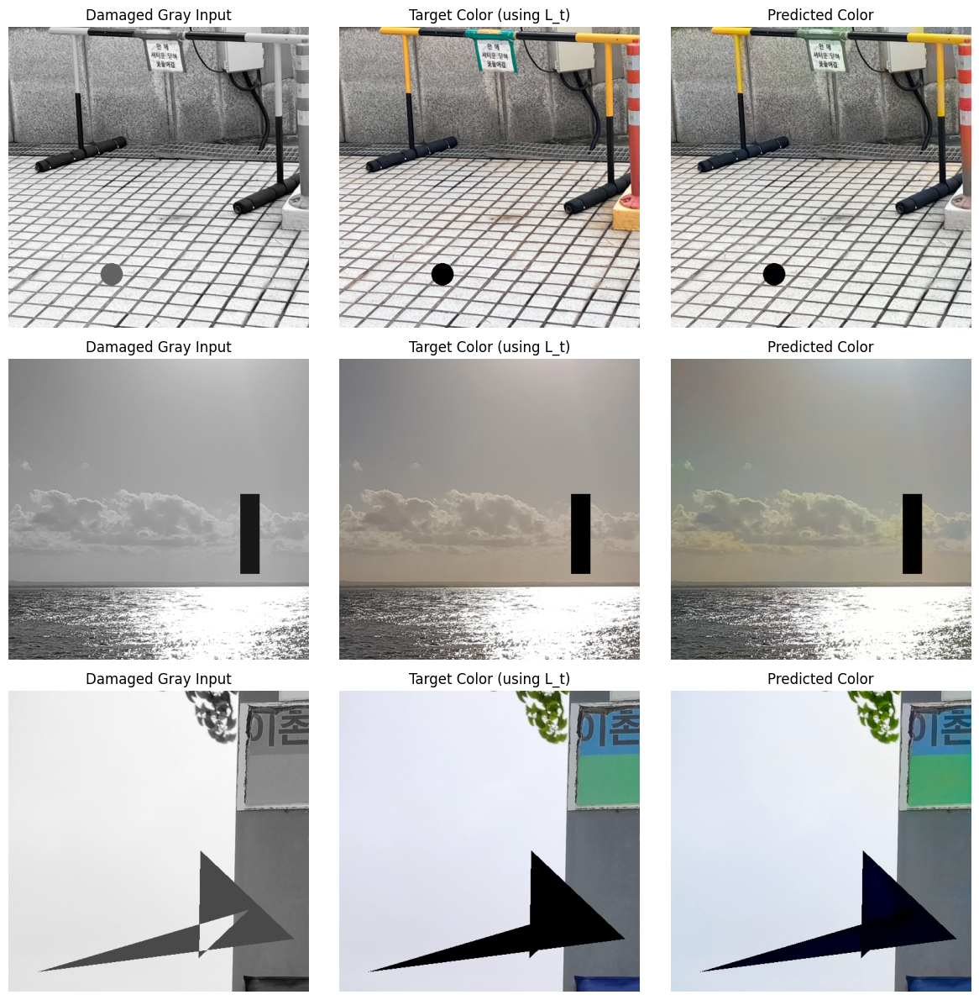

Epoch [5/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [5/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [5/50] Train Loss: 0.0432, Val Loss: 0.0460
Epoch [5] Mean SSIM (no-mask): 0.9903, Mean Histogram Similarity (no-mask): 0.5204
Epoch [5] Combined Metric (no-mask): 0.5154


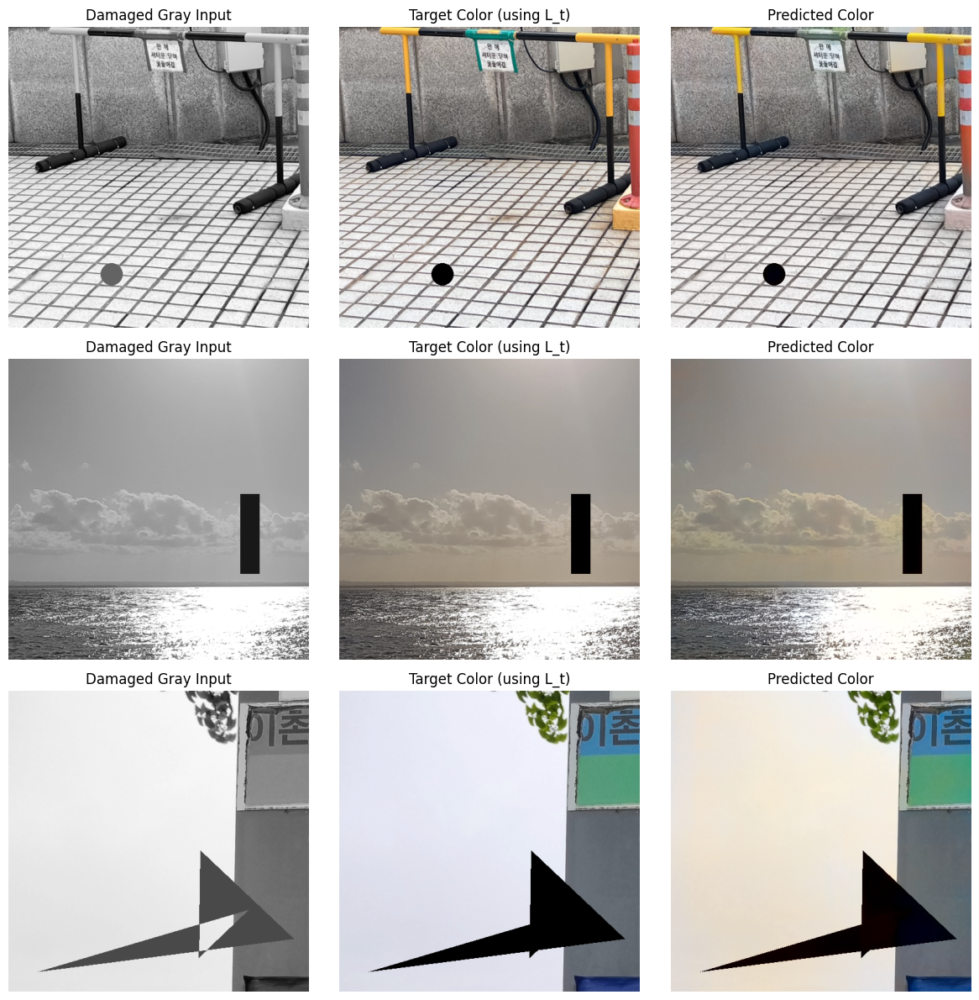

Epoch [6/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [6/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [6/50] Train Loss: 0.0424, Val Loss: 0.0439
Epoch [6] Mean SSIM (no-mask): 0.9913, Mean Histogram Similarity (no-mask): 0.6402
Epoch [6] Combined Metric (no-mask): 0.6346
** Best Model Updated and Saved! **


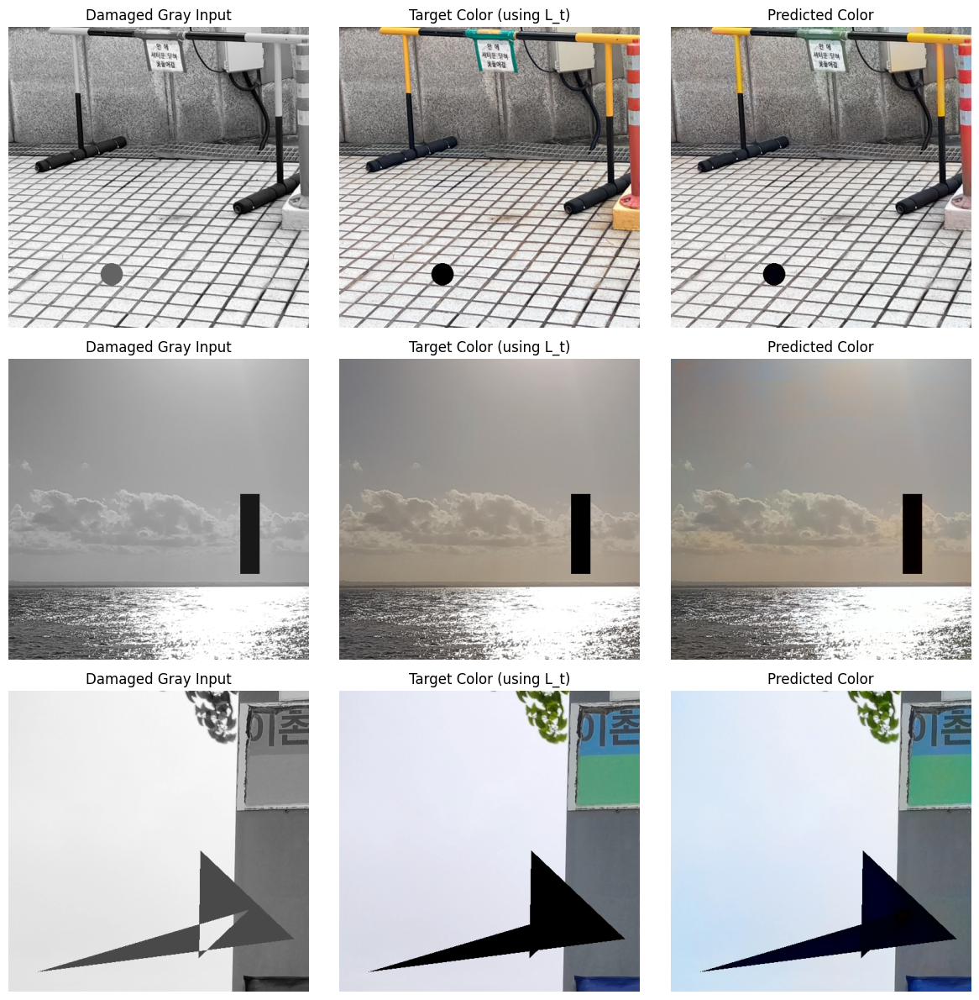

Epoch [7/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [7/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [7/50] Train Loss: 0.0414, Val Loss: 0.0434
Epoch [7] Mean SSIM (no-mask): 0.9922, Mean Histogram Similarity (no-mask): 0.6583
Epoch [7] Combined Metric (no-mask): 0.6532
** Best Model Updated and Saved! **


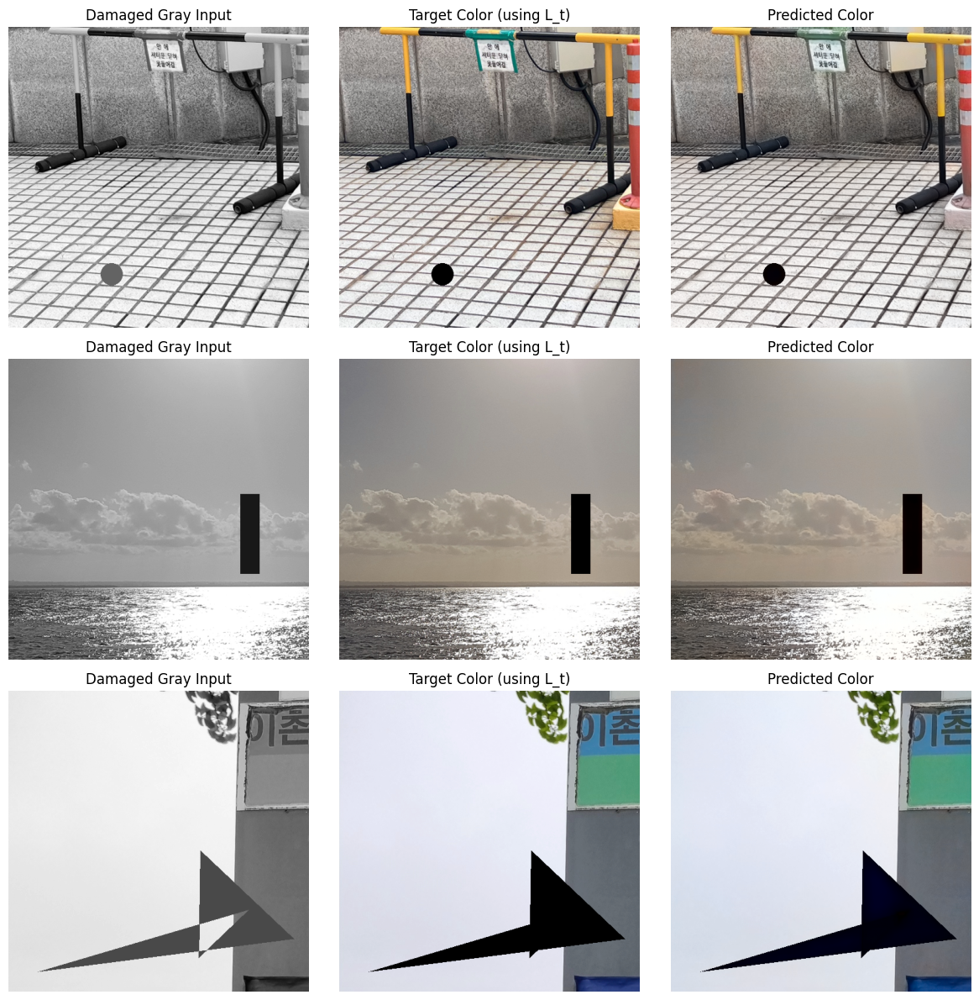

Epoch [8/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [8/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [8/50] Train Loss: 0.0419, Val Loss: 0.0519
Epoch [8] Mean SSIM (no-mask): 0.9910, Mean Histogram Similarity (no-mask): 0.2831
Epoch [8] Combined Metric (no-mask): 0.2806


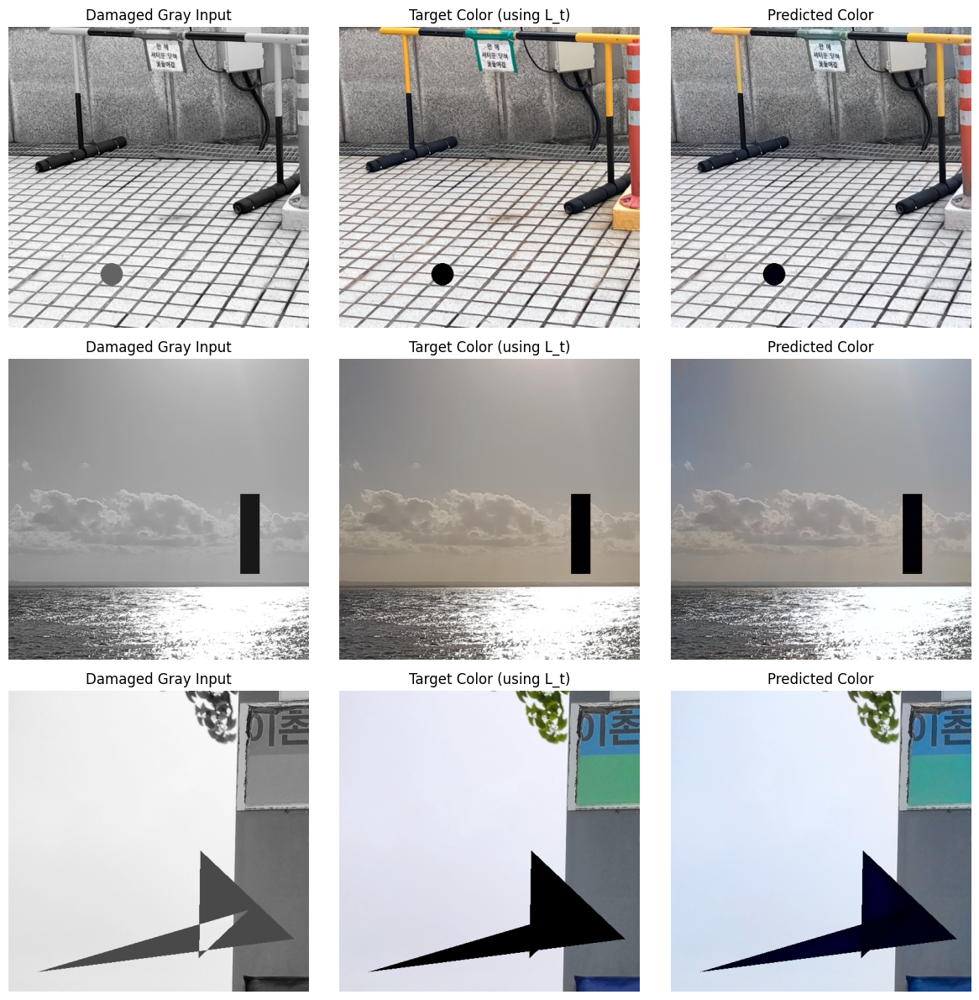

Epoch [9/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [9/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [9/50] Train Loss: 0.0417, Val Loss: 0.0428
Epoch [9] Mean SSIM (no-mask): 0.9919, Mean Histogram Similarity (no-mask): 0.4912
Epoch [9] Combined Metric (no-mask): 0.4872


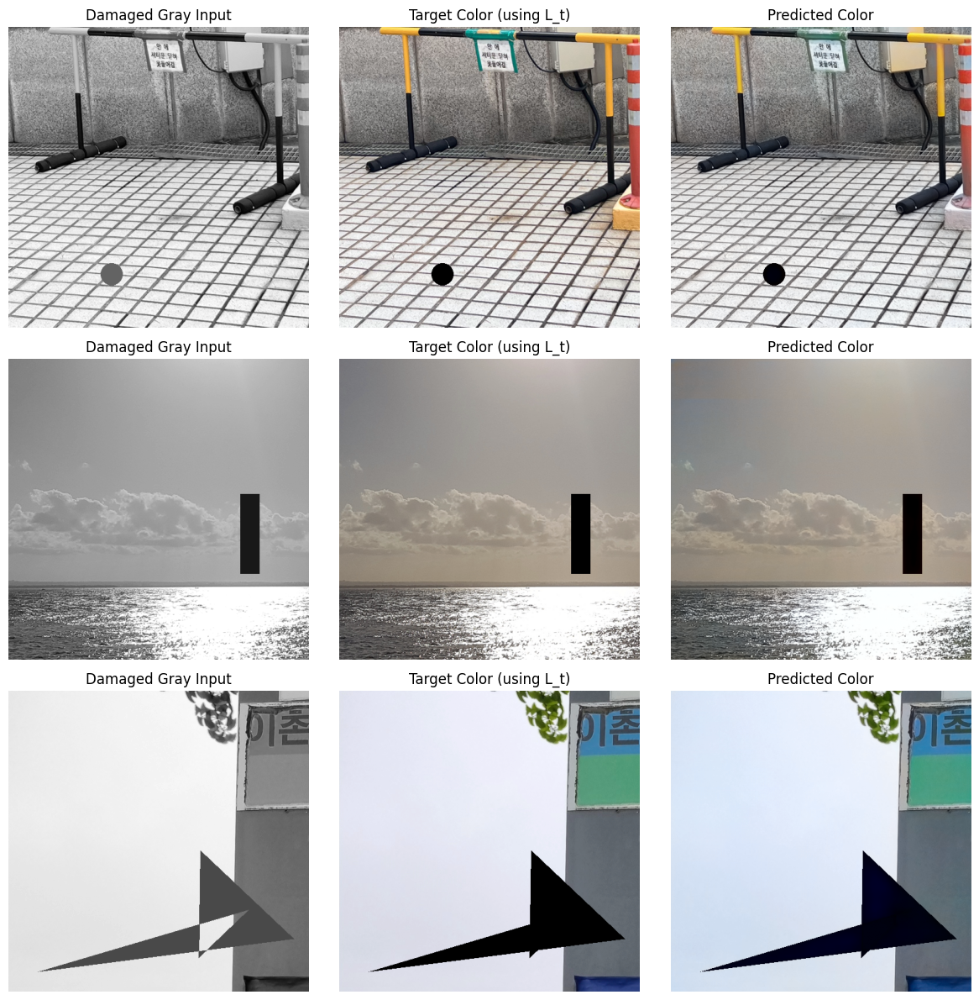

Epoch [10/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

Epoch [10/50] Validation:   0%|          | 0/297 [00:00<?, ?it/s]

Epoch [10/50] Train Loss: 0.0405, Val Loss: 0.0492
Epoch [10] Mean SSIM (no-mask): 0.9897, Mean Histogram Similarity (no-mask): 0.5880
Epoch [10] Combined Metric (no-mask): 0.5819


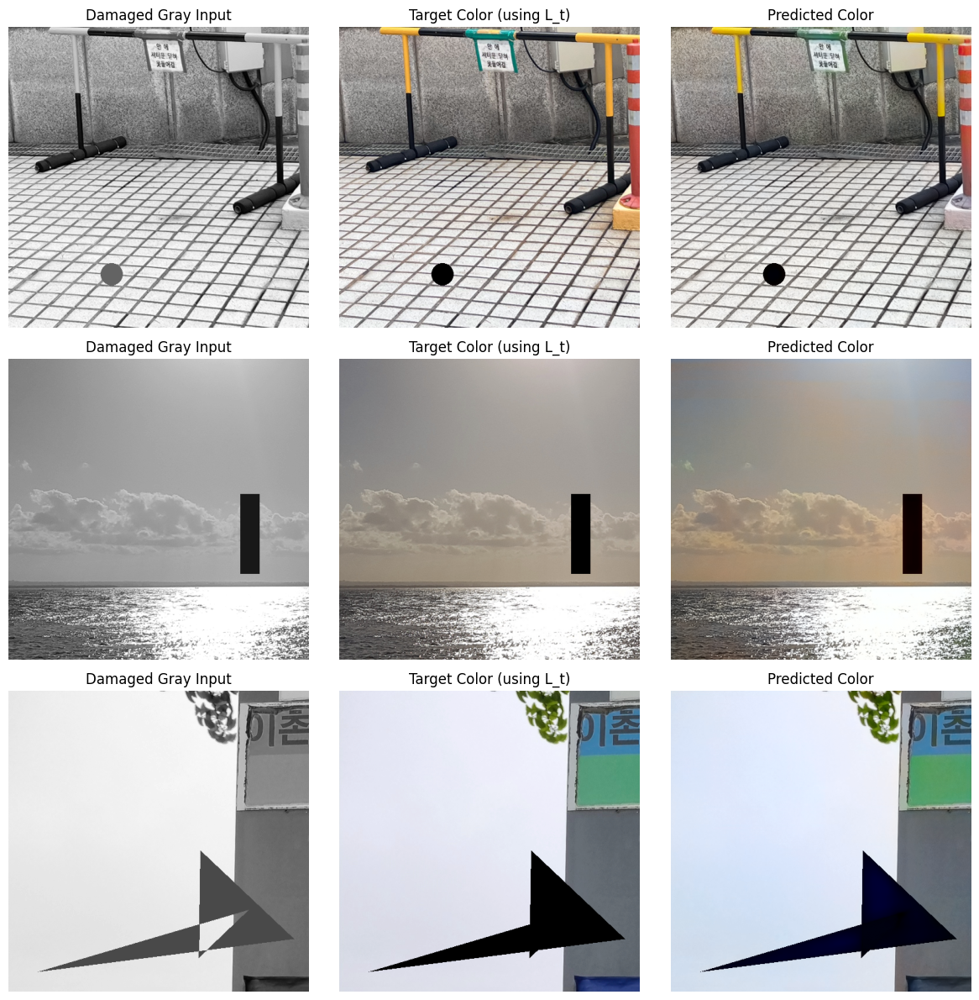

Epoch [11/50] Training:   0%|          | 0/1185 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
import os
import glob
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torchvision import transforms, models
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tqdm.auto import tqdm
from skimage.metrics import structural_similarity as ssim
from torchvision.models import resnet50, ResNet50_Weights

####################
# 파라미터 설정
####################
gray_dir = "/root/.cache/kagglehub/datasets/geon05/dataset2/versions/1/train_input"
color_dir = "/root/.cache/kagglehub/datasets/geon05/damages-masks/versions/1/damage_images/damage_images"
mask_dir = "/root/.cache/kagglehub/datasets/geon05/damages-masks/versions/1/output_masks/output_masks"

batch_size =20
lr = 1e-4
epochs = 50
test_size = 0.2
lambda_perc = 0.1  # Perceptual Loss 가중치

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

####################
# Lab 변환 함수
####################
def rgb_to_lab_normalized(rgb):
    rgb_np = (rgb.permute(1,2,0).numpy() * 255).astype(np.uint8)
    bgr = cv2.cvtColor(rgb_np, cv2.COLOR_RGB2BGR)
    lab = cv2.cvtColor(bgr, cv2.COLOR_BGR2Lab).astype(np.float32)
    L = lab[:,:,0] / 255.0
    a = (lab[:,:,1] - 128.0)/128.0
    b = (lab[:,:,2] - 128.0)/128.0
    return L, a, b

def lab_to_rgb(L, a, b):
    lab_0_255 = np.zeros((L.shape[0], L.shape[1], 3), dtype=np.float32)
    lab_0_255[:,:,0] = L * 255.0
    lab_0_255[:,:,1] = a * 128.0 + 128.0
    lab_0_255[:,:,2] = b * 128.0 + 128.0
    lab_0_255 = np.clip(lab_0_255, 0, 255).astype(np.uint8)
    bgr = cv2.cvtColor(lab_0_255, cv2.COLOR_Lab2BGR)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    rgb = np.clip(rgb,0,255).astype(np.uint8)
    return rgb / 255.0

####################
# SSIM, Histogram Similarity
####################
def ssim_score(true, pred):
    return ssim(true, pred, channel_axis=-1, data_range=1.0)

def histogram_similarity(true, pred):
    true_bgr = cv2.cvtColor((true*255).astype(np.uint8), cv2.COLOR_RGB2BGR)
    pred_bgr = cv2.cvtColor((pred*255).astype(np.uint8), cv2.COLOR_RGB2BGR)
    true_hsv = cv2.cvtColor(true_bgr, cv2.COLOR_BGR2HSV)
    pred_hsv = cv2.cvtColor(pred_bgr, cv2.COLOR_BGR2HSV)
    hist_true = cv2.calcHist([true_hsv], [0], None, [180], [0, 180])
    hist_pred = cv2.calcHist([pred_hsv], [0], None, [180], [0, 180])
    hist_true = cv2.normalize(hist_true, hist_true).flatten()
    hist_pred = cv2.normalize(hist_pred, hist_pred).flatten()
    return cv2.compareHist(hist_true, hist_pred, cv2.HISTCMP_CORREL)

####################
# VGGPerceptualLoss 정의
####################
class VGGPerceptualLoss(nn.Module):
    def __init__(self, layer_ids=[3,8]):
        super().__init__()
        vgg = models.vgg16(weights=models.VGG16_Weights.DEFAULT).features
        self.layers = nn.ModuleList([vgg[i] for i in range(max(layer_ids)+1)])
        self.layer_ids = layer_ids
        for param in self.layers.parameters():
            param.requires_grad = False
    def forward(self, x):
        mean = torch.tensor([0.485,0.456,0.406], device=x.device).view(1,3,1,1)
        std = torch.tensor([0.229,0.224,0.225], device=x.device).view(1,3,1,1)
        x = (x - mean) / std
        feats = []
        for i, layer in enumerate(self.layers):
            x = layer(x)
            if i in self.layer_ids:
                feats.append(x)
        return feats

####################
# UpConv 및 DoubleConv 클래스
####################
class UpConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(UpConv, self).__init__()
        self.up = nn.ConvTranspose2d(in_ch, out_ch, kernel_size=2, stride=2)
    def forward(self, x):
        return self.up(x)

class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

####################
# Dataset 정의 (마스크 추가)
####################
class DamagedGrayColorDataset(Dataset):
    def __init__(self, gray_paths, color_paths, mask_paths, transform_gray=None, transform_color=None):
        self.gray_paths = gray_paths
        self.color_paths = color_paths
        self.mask_paths = mask_paths
        self.transform_gray = transform_gray
        self.transform_color = transform_color
        assert len(self.gray_paths) == len(self.color_paths) == len(self.mask_paths)

    def __len__(self):
        return len(self.gray_paths)

    def __getitem__(self, idx):
        g_path = self.gray_paths[idx]
        c_path = self.color_paths[idx]
        m_path = self.mask_paths[idx]

        gray_img = Image.open(g_path).convert('L')
        color_img = Image.open(c_path).convert('RGB')
        mask_img = Image.open(m_path).convert('L')  # 0~255 범위, 255=손상?

        # 마스크 이진화
        mask_np = np.array(mask_img)
        mask_bin = (mask_np > 128).astype(np.float32)
        mask_bin = torch.from_numpy(mask_bin).unsqueeze(0) # [1,H,W]

        if self.transform_gray:
            gray_img = self.transform_gray(gray_img)
        if self.transform_color:
            color_img = self.transform_color(color_img)

        # 타겟 Lab 변환
        L_t, a_t, b_t = rgb_to_lab_normalized(color_img)
        a_t = torch.from_numpy(a_t).unsqueeze(0)
        b_t = torch.from_numpy(b_t).unsqueeze(0)
        ab_t = torch.cat([a_t, b_t], dim=0)
        L_t = torch.from_numpy(L_t).unsqueeze(0)

        # Gray->RGB->Lab L 변환
        gray_3ch = torch.cat([gray_img,gray_img,gray_img], dim=0)
        G_L, G_a, G_b = rgb_to_lab_normalized(gray_3ch)
        G_L = torch.from_numpy(G_L).unsqueeze(0)

        return G_L, ab_t, L_t, mask_bin

transform_gray = transforms.Compose([
    transforms.Resize((512,512)),
    transforms.ToTensor()
])

transform_color = transforms.Compose([
    transforms.Resize((512,512)),
    transforms.ToTensor()
])

gray_files = sorted(glob.glob(os.path.join(gray_dir, "*")))
color_files = sorted(glob.glob(os.path.join(color_dir, "*")))

mask_files = []
for gf in gray_files:
    fname = os.path.basename(gf)
    m_path = os.path.join(mask_dir, fname)
    mask_files.append(m_path)

train_gray, val_gray, train_color, val_color, train_mask, val_mask = train_test_split(
    gray_files, color_files, mask_files, test_size=test_size, random_state=42
)

train_dataset = DamagedGrayColorDataset(train_gray, train_color, train_mask, transform_gray, transform_color)
val_dataset = DamagedGrayColorDataset(val_gray, val_color, val_mask, transform_gray, transform_color)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

####################
# ResNetEncoder (ResNet-50)
####################
class ResNetEncoder(nn.Module):
    def __init__(self, pretrained=True):
        super().__init__()
        net = models.resnet50(weights=ResNet50_Weights.DEFAULT if pretrained else None)
        self.initial = nn.Sequential(net.conv1, net.bn1, net.relu)
        self.maxpool = net.maxpool
        self.layer1 = net.layer1 # 256채널
        self.layer2 = net.layer2 # 512채널
        self.layer3 = net.layer3 # 1024채널
        self.layer4 = net.layer4 # 2048채널

    def forward(self, x):
        x0 = self.initial(x)   #64채널
        x1 = self.maxpool(x0)
        x1 = self.layer1(x1)   #256채널
        x2 = self.layer2(x1)   #512채널
        x3 = self.layer3(x2)   #1024채널
        x4 = self.layer4(x3)   #2048채널
        return x0, x1, x2, x3, x4

####################
# 디코더 부분 (ResNet-50에 맞게)
####################
class ResNetUNet(nn.Module):
    def __init__(self, out_ch=2, pretrained=True):
        super().__init__()
        self.encoder = ResNetEncoder(pretrained=pretrained)
        self.up3 = UpConv(2048, 1024)
        self.dec3 = DoubleConv(2048, 1024)
        self.up2 = UpConv(1024, 512)
        self.dec2 = DoubleConv(1024, 512)
        self.up1 = UpConv(512, 256)
        self.dec1 = DoubleConv(512, 256)
        self.up0 = UpConv(256, 64)
        self.dec0 = DoubleConv(128, 64)
        self.up_final = UpConv(64,64)
        self.dec_final = DoubleConv(64,64)
        self.final_out = nn.Conv2d(64, out_ch, 1)

    def forward(self, x):
        x = x.repeat(1,3,1,1)
        x0, x1, x2, x3, x4 = self.encoder(x)
        x_up3 = self.up3(x4)
        x_cat3 = torch.cat([x_up3, x3], dim=1)
        x_dec3 = self.dec3(x_cat3)

        x_up2 = self.up2(x_dec3)
        x_cat2 = torch.cat([x_up2, x2], dim=1)
        x_dec2 = self.dec2(x_cat2)

        x_up1 = self.up1(x_dec2)
        x_cat1 = torch.cat([x_up1, x1], dim=1)
        x_dec1 = self.dec1(x_cat1)

        x_up0 = self.up0(x_dec1)
        x_cat0 = torch.cat([x_up0, x0], dim=1)
        x_dec0 = self.dec0(x_cat0)

        x_upf = self.up_final(x_dec0)
        x_decf = self.dec_final(x_upf)
        out = self.final_out(x_decf)
        return out

model = ResNetUNet(out_ch=2, pretrained=True).to(device)
perceptual_extractor = VGGPerceptualLoss(layer_ids=[3,8]).to(device)
mse_loss = nn.MSELoss(reduction='none')

def compute_loss(L_img, ab_img, pred_ab, L_t_img, mask):
    # 마스크 제외한 영역만 손실 계산
    diff = mse_loss(pred_ab, ab_img)
    valid_area = (1 - mask)
    diff = diff * valid_area
    denom = valid_area.sum() + 1e-8
    l1_val = diff.sum() / denom

    B = L_img.size(0)
    ab_np = ab_img.permute(0,2,3,1).cpu().numpy()
    pred_ab_np = pred_ab.permute(0,2,3,1).detach().cpu().numpy()
    L_t_np = L_t_img[:,0].cpu().numpy()

    true_rgb_list = []
    pred_rgb_list = []
    for i in range(B):
        trgb = lab_to_rgb(L_t_np[i], ab_np[i][:,:,0], ab_np[i][:,:,1])
        prgb = lab_to_rgb(L_t_np[i], pred_ab_np[i][:,:,0], pred_ab_np[i][:,:,1])
        true_rgb_list.append(trgb)
        pred_rgb_list.append(prgb)

    true_rgb_t = torch.from_numpy(np.stack(true_rgb_list,axis=0)).float().to(device)
    pred_rgb_t = torch.from_numpy(np.stack(pred_rgb_list,axis=0)).float().to(device)
    true_rgb_t = true_rgb_t.permute(0,3,1,2)
    pred_rgb_t = pred_rgb_t.permute(0,3,1,2)

    true_feats = perceptual_extractor(true_rgb_t)
    pred_feats = perceptual_extractor(pred_rgb_t)

    perc_loss_val = torch.tensor(0.0, device=device)
    for ft, fp in zip(true_feats, pred_feats):
        perc_diff = (ft - fp)**2
        down_mask = F.interpolate(valid_area, size=ft.shape[2:], mode='bilinear', align_corners=False)
        down_mask_3ch = down_mask.repeat(1,ft.shape[1],1,1)
        perc_diff = perc_diff * down_mask_3ch
        perc_sum = perc_diff.sum()
        perc_count = down_mask_3ch.sum() + 1e-8
        perc_loss_val += perc_sum / perc_count

    total_loss = l1_val + lambda_perc * perc_loss_val
    return total_loss, l1_val, perc_loss_val

def visualize_samples(model, data_loader, device, num_samples=3):
    model.eval()
    with torch.no_grad():
        val_iter = iter(data_loader)
        L_batch, ab_batch, L_t_batch, mask_batch = next(val_iter)
        L_batch = L_batch.to(device)
        pred_ab = model(L_batch)

    fig, axes = plt.subplots(num_samples, 3, figsize=(12, 4 * num_samples))
    if num_samples == 1:
        axes = [axes]

    for i in range(num_samples):
        L_np = L_batch[i,0].cpu().numpy()
        ab_true = ab_batch[i].permute(1,2,0).numpy()
        L_t_np = L_t_batch[i,0].numpy()
        pred_ab_np = pred_ab[i].cpu().permute(1,2,0).numpy()

        true_rgb = lab_to_rgb(L_t_np, ab_true[:,:,0], ab_true[:,:,1])
        pred_rgb = lab_to_rgb(L_t_np, pred_ab_np[:,:,0], pred_ab_np[:,:,1])

        axes[i][0].imshow(L_np, cmap='gray')
        axes[i][0].set_title("Damaged Gray Input")
        axes[i][0].axis('off')

        axes[i][1].imshow(true_rgb)
        axes[i][1].set_title("Target Color (using L_t)")
        axes[i][1].axis('off')

        axes[i][2].imshow(pred_rgb)
        axes[i][2].set_title("Predicted Color")
        axes[i][2].axis('off')

    plt.tight_layout()
    plt.show()

optimizer = optim.Adam(model.parameters(), lr=lr)

checkpoint_path = "/content/20241207_05_best_model_1_0.046.pth"
if os.path.exists(checkpoint_path):
    state_dict = torch.load(checkpoint_path, map_location=device, weights_only=True)
    model.load_state_dict(state_dict)
    print(f"Loaded model state from {checkpoint_path}, continuing training...")

best_val_loss = float('inf')
best_combined_metric = float('-inf')

for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    train_pbar = tqdm(train_loader, desc=f"Epoch [{epoch+1}/{epochs}] Training")
    for L_img, ab_img, L_t_img, mask in train_pbar:
        L_img, ab_img, L_t_img, mask = L_img.to(device), ab_img.to(device), L_t_img.to(device), mask.to(device)
        optimizer.zero_grad()
        pred_ab = model(L_img)
        total_loss, l1_val, perc_val = compute_loss(L_img, ab_img, pred_ab, L_t_img, mask)
        total_loss.backward()
        optimizer.step()
        running_loss += total_loss.item()
        train_pbar.set_postfix(loss=total_loss.item(), L1=l1_val.item(), Perc=perc_val.item())

    avg_train_loss = running_loss / len(train_loader)

    model.eval()
    val_loss = 0.0
    ssim_list = []
    hist_sim_list = []
    val_pbar = tqdm(val_loader, desc=f"Epoch [{epoch+1}/{epochs}] Validation")

    with torch.no_grad():
        for i, (L_img, ab_img, L_t_img, mask) in enumerate(val_pbar):
            L_img, ab_img, L_t_img, mask = L_img.to(device), ab_img.to(device), L_t_img.to(device), mask.to(device)
            pred_ab = model(L_img)
            total_loss, l1_val, perc_val = compute_loss(L_img, ab_img, pred_ab, L_t_img, mask)
            val_loss += total_loss.item()
            val_pbar.set_postfix(val_loss=total_loss.item(), L1=l1_val.item(), Perc=perc_val.item())

            # 마스크를 제외한 부분만을 반영한 SSIM/히스토그램 계산
            # 첫 배치에 대해 몇 장만 측정 (원래 코드 로직 유지)
            if i == 0:
                num_samples = min(3, ab_img.size(0))
                L_np_all = L_img[:,0].cpu().numpy()
                ab_t_np_all = ab_img.permute(0,2,3,1).cpu().numpy()
                pred_ab_np_all = pred_ab.permute(0,2,3,1).cpu().numpy()
                L_t_np_all = L_t_img[:,0].cpu().numpy()
                mask_np_all = mask[:,0].cpu().numpy()
                for j in range(num_samples):
                    true_rgb = lab_to_rgb(L_t_np_all[j], ab_t_np_all[j][:,:,0], ab_t_np_all[j][:,:,1])
                    pred_rgb = lab_to_rgb(L_t_np_all[j], pred_ab_np_all[j][:,:,0], pred_ab_np_all[j][:,:,1])
                    # 마스크 제외: masked area -> 0으로 set
                    valid_area = (1 - mask_np_all[j]) # [H,W]
                    valid_area_3ch = np.stack([valid_area]*3, axis=-1) # [H,W,3]

                    # 마스크 영역 0으로 만들기
                    true_rgb = true_rgb * valid_area_3ch
                    pred_rgb = pred_rgb * valid_area_3ch

                    current_ssim = ssim_score(true_rgb, pred_rgb)
                    ssim_list.append(current_ssim)
                    current_hist_sim = histogram_similarity(true_rgb, pred_rgb)
                    hist_sim_list.append(current_hist_sim)

    avg_val_loss = val_loss / len(val_loader)
    print(f"Epoch [{epoch+1}/{epochs}] Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")

    if len(ssim_list) > 0:
        mean_ssim = np.mean(ssim_list)
        mean_hist_sim = np.mean(hist_sim_list)
        print(f"Epoch [{epoch+1}] Mean SSIM (no-mask): {mean_ssim:.4f}, Mean Histogram Similarity (no-mask): {mean_hist_sim:.4f}")
        combined_metric = mean_ssim * mean_hist_sim
        print(f"Epoch [{epoch+1}] Combined Metric (no-mask): {combined_metric:.4f}")

        # 최적 모델은 마스크 제외 영역 품질 기준
        if combined_metric > best_combined_metric:
            best_combined_metric = combined_metric
            torch.save(model.state_dict(), f"20241207_05_best_model_{epoch+1}_{avg_val_loss:.3f}.pth")
            print("** Best Model Updated and Saved! **")

    visualize_samples(model, val_loader, device, num_samples=3)
